In [1]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
from IPython.display import HTML

In [2]:
import pdb
import cv2
import pandas as pd
import numpy as np
from PIL import Image
from pathlib import Path
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import axes3d, Axes3D

from lyft_dataset_sdk.lyftdataset import LyftDataset, LyftDatasetExplorer, Quaternion, view_points
from lyft_dataset_sdk.utils.data_classes import LidarPointCloud


from tqdm import tqdm_notebook as tqdm

%matplotlib inline

In [3]:
lyftdata = LyftDataset(data_path='F:/3d dataset on yolo/data/', json_path='F:/3d dataset on yolo/data/train_data/', verbose=True)

9 category,
18 attribute,
4 visibility,
18421 instance,
10 sensor,
148 calibrated_sensor,
177789 ego_pose,
180 log,
180 scene,
22680 sample,
189504 sample_data,
638179 sample_annotation,
1 map,
Done loading in 18.3 seconds.
Reverse indexing ...
Done reverse indexing in 4.3 seconds.


In [4]:
lyftdata.category[0]

{'description': '',
 'token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c',
 'name': 'car'}

In [5]:
cat_token = lyftdata.category[0]['token']
cat_token

'8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c'

In [6]:
lyftdata.get('category', cat_token)

{'description': '',
 'token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c',
 'name': 'car'}

In [7]:
lyftdata.sample_annotation[0]

{'token': '92bff46db1dbfc9679edc8091770c4256ac3c027e9f0a9c31dfc4fff41f6f677',
 'num_lidar_pts': -1,
 'size': [2.064, 5.488, 2.053],
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'rotation': [0.265491936795379, 0, 0, 0.964113080243515],
 'prev': 'db2c5aea69d8be40a746c5f3df9366e030189b07647212f338b31240c15896df',
 'translation': [2680.2830359778527, 698.1969292852777, -18.04776692365821],
 'num_radar_pts': 0,
 'attribute_tokens': ['1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2',
  'daf16a3f6499553cc5e1df4a456de5ee46e2e6b06544686d918dfb1ddb088f6f'],
 'next': '33e07b849d62718279c9548fe662d32247e319f0451cd461059305c3e42dcea0',
 'instance_token': 'abea2eb040d9c8fa1a44fa54020daaf9e2aa696e95e1d257481ecbf6e13a318c',
 'visibility_token': '',
 'category_name': 'car'}

In [8]:
lyftdata.get('attribute', lyftdata.sample_annotation[0]['attribute_tokens'][0])

{'description': '',
 'token': '1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2',
 'name': 'object_action_stopped'}

In [9]:
lyftdata.scene[0]

{'log_token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100',
 'first_sample_token': '24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8',
 'name': 'host-a101-lidar0-1241893239199111666-1241893264098084346',
 'description': '',
 'last_sample_token': '2346756c83f6ae8c4d1adec62b4d0d31b62116d2e1819e96e9512667d15e7cec',
 'nbr_samples': 126,
 'token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100'}

In [10]:
train = pd.read_csv('F:/3d dataset on yolo/data/train.csv')
train.head()

,Id,PredictionString
0,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,2680.2830359778527 698.1969292852777 -18.04776...
1,edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e...,1208.642684768659 1585.1812946970927 -23.56236...
2,1841b7895e7163a2c1be87e8c1740e759a910cd59157b8...,848.9346793681768 2587.2870557176507 -20.15995...
3,a970c764e7abd7ebc2cc4599a6e3ae58c9773ea3c9cf1d...,1994.4320280494098 1128.30164336183 -18.054752...
4,b909de93ba19460eeea58074ccc1ef6bb302435f37b48c...,1030.3877156973385 1667.13131694941 -23.764820...


In [11]:
token0 = train.iloc[0]['Id']
token0

'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341'

In [12]:
my_sample = lyftdata.get('sample', token0)
my_sample

{'next': 'd68e30dca1dadc71d6f15ed9c7f35cadc9c795e74fc721d668baf9753c07089e',
 'prev': 'cf9e605d1b1a1bc8d8340ad79f49c4993d75fa4171d2cad99d11a0dca5923cd5',
 'token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'scene_token': 'a9a990d6d215b494a939fba57385566732b9ce0b44b2a000fd23cc25d71cf075',
 'timestamp': 1558109692502687.0,
 'data': {'CAM_FRONT': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
  'CAM_BACK_LEFT': '521ca50fff810fcb6f70170f6a6b48709e55164902e34df1e8e3d95b5b56572e',
  'CAM_FRONT_RIGHT': 'e35731e7cc91018cbafd323f635d97ccbd948642c19937b85521bd2f9918efcc',
  'CAM_BACK': '762f245c3f3a0cfe3a9bc97eb321eb71522eaff0904469693b9c712041fcf0a1',
  'CAM_BACK_RIGHT': '89ef38638f8f4cbd932f693e934c4022681de809417a50679c9b20914286efb5',
  'LIDAR_FRONT_RIGHT': '0d3a497e9c99f8a4697e0e9d2644a8a7e3bd20143b58dba8285b63dd1715b794',
  'CAM_FRONT_LEFT': 'a8b62cfacbdb74d34051f2ace4e3e89c8eb19bab1c8830ab16a5b671a3bc9971',
  'LIDAR_TOP': 'f2f0d25a268a7a7112

In [13]:
lyftdata.render_sample_3d_interactive(my_sample['token'], render_sample=False)

In [14]:
my_sample.keys()

dict_keys(['next', 'prev', 'token', 'scene_token', 'timestamp', 'data', 'anns'])

In [15]:
lyftdata.sensor

[{'modality': 'camera',
  'channel': 'CAM_FRONT_LEFT',
  'token': 'f7dad6bb70cb8e6245f96e5537e382848335872e6e259218b0a80cc071d162c4'},
 {'modality': 'lidar',
  'channel': 'LIDAR_FRONT_LEFT',
  'token': '629da739ea3a0814b9d79ffc3b99cdbc8bdbb6f97abf139f1ad33bd12f8fa94d'},
 {'modality': 'camera',
  'channel': 'CAM_FRONT',
  'token': 'eb9e8f60a3d6e3328d7512b9f8e6800127fe91f4d62bc8e48a0e6a7cb116cc60'},
 {'modality': 'lidar',
  'channel': 'LIDAR_TOP',
  'token': '25bf751d7e35f295393d8a418731474b21c1f702e878c4553f112397caa48c08'},
 {'modality': 'camera',
  'channel': 'CAM_BACK_LEFT',
  'token': 'c84592e22beb2c0f14d5159245ce8d6678431b879e940eed580651c09cc7d2f1'},
 {'modality': 'lidar',
  'channel': 'LIDAR_FRONT_RIGHT',
  'token': '953faed96fd3d2fae3ec03cd2838b312b8c1a9bb7a0629481982870cb28acb67'},
 {'modality': 'camera',
  'channel': 'CAM_BACK',
  'token': '172a55e2b50f18a6b6d545369a457003c2f3b438d0180b2b4c7819ca29b3f6ab'},
 {'modality': 'camera',
  'channel': 'CAM_BACK_RIGHT',
  'token': '8e0

We can use `data` key of a given sample to access one of these, like:

In [16]:
sensor = 'CAM_FRONT'
cam_front = lyftdata.get('sample_data', my_sample['data'][sensor])
cam_front

{'width': 1920,
 'height': 1080,
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'token': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
 'calibrated_sensor_token': '8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de86ead47fa25fd13fd20',
 'is_key_frame': True,
 'prev': 'f1c11f633b14f1d6405ce6dc83d5aa7dc4786ac1bad50588028edfca372cec7a',
 'fileformat': 'jpeg',
 'ego_pose_token': 'dfba284cabe099bbe89ff13355a7702828d02709f82579f1e49081479cb09dfe',
 'timestamp': 1558109692450000.0,
 'next': '000a8a46b2868cfa04c4d0ceaa4e082ac7bfa7eecfce8c415148c3676e9a876d',
 'filename': 'images/host-a101_cam0_1242144892450000006.jpeg',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

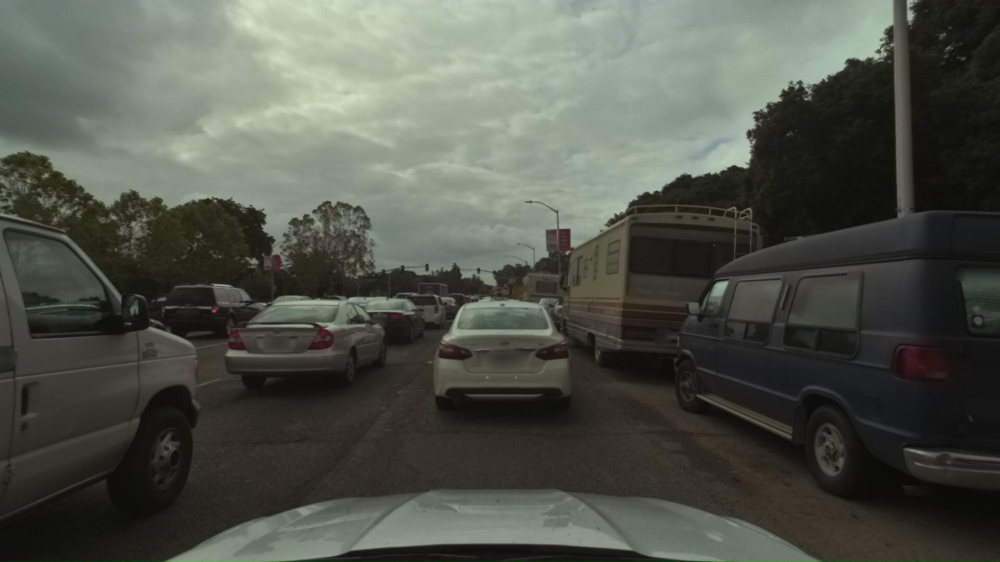

In [17]:
img = Image.open(cam_front['filename'])
img

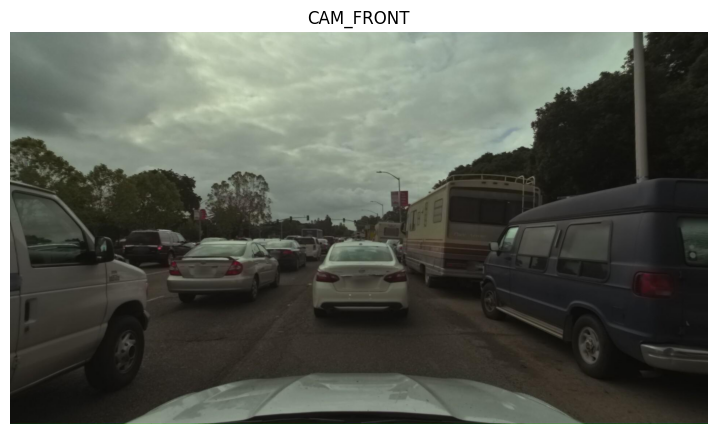

In [18]:
lyftdata.render_sample_data(cam_front['token'], with_anns=False)

let's take a look at the LIDAR data associated with `my_sample`

In [19]:
lidar_top = lyftdata.get('sample_data', my_sample['data']['LIDAR_TOP']) 
lidar_top

{'is_key_frame': True,
 'prev': 'd8c2b6f50e7994c708174f077eaca66c92e7358a3cee6df32fc212b05de3c423',
 'fileformat': 'bin',
 'ego_pose_token': 'e36a9a1c02de786a9ac136640955071e1eda14659f5c75ce96b7dbc37ce52491',
 'timestamp': 1558109692502687.0,
 'next': 'a035b707c04a511ce924bdab277378a152467c778057656389eafa27875e9468',
 'token': 'f2f0d25a268a7a7112be881669bf0b4848ae591c8c70de1a8e562b81c45654d4',
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'filename': 'lidar/host-a101_lidar1_1242144892502687076.bin',
 'calibrated_sensor_token': '82130f5d48b806b62fec95989081337218fbf338ebcc95115d8afcebb305630c',
 'sensor_modality': 'lidar',
 'channel': 'LIDAR_TOP'}

In [20]:
pc = LidarPointCloud.from_file(Path(lidar_top['filename']))

In [21]:
pc.points.shape 

(4, 106940)

Let's visualize these lidar points

In [22]:
axes_limits = [
    [-30, 50],
    [-30, 20], 
    [-3, 10]   
]
axes_str = ['X', 'Y', 'Z']

def display_frame_statistics(lidar_points, points=0.2):
    """
    Displays statistics for a single frame. Draws 3D plot of the lidar point cloud data and point cloud
    projections to various planes.
    
    Parameters
    ----------
    lidar_points: lidar data points 
    points          : Fraction of lidar points to use. Defaults to `0.2`, e.g. 20%.
    """
    
    points_step = int(1. / points)
    point_size = 0.01 * (1. / points)
    pc_range = range(0, lidar_points.shape[1], points_step)
    pc_frame = lidar_points[:, pc_range]
    def draw_point_cloud(ax, title, axes=[0, 1, 2]):
        """Convenient method for drawing various point cloud projections as a part of frame statistics"""
        ax.set_facecolor('black')
        ax.grid(False)
        ax.scatter(*pc_frame[axes, :], s=point_size, c='white', cmap='grey')
        if len(axes) == 3: 
            text_color = 'white'
            ax.set_xlim3d([-10, 30])
            ax.set_ylim3d(*axes_limits[axes[1]])
            ax.set_zlim3d(*axes_limits[axes[2]])
            ax.set_zlabel('{} axis'.format(axes_str[axes[2]]), color='white')
        else: 
            text_color = 'black' 
            ax.set_xlim(*axes_limits[axes[0]])
            ax.set_ylim(*axes_limits[axes[1]])
        ax.set_title(title, color=text_color)
        ax.set_xlabel('{} axis'.format(axes_str[axes[0]]), color=text_color)
        ax.set_ylabel('{} axis'.format(axes_str[axes[1]]), color=text_color)
            
   
    f2 = plt.figure(figsize=(15, 8))
    ax2 = f2.add_subplot(111, projection='3d')
 
    ax2.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax2.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax2.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    draw_point_cloud(ax2, '3D plot')
    
    plt.show()
    plt.close(f2)
  
    f, ax3 = plt.subplots(3, 1, figsize=(15, 25))

    draw_point_cloud(
        ax3[0], 
        'XZ projection (Y = 0)',
        axes=[0, 2]
    )
    draw_point_cloud(
        ax3[1], 
        'XY projection (Z = 0)',
        axes=[0, 1] 
    )
    draw_point_cloud(
        ax3[2], 
        'YZ projection (X = 0)', 
        axes=[1, 2] 
    )
    plt.show()
    plt.close(f)

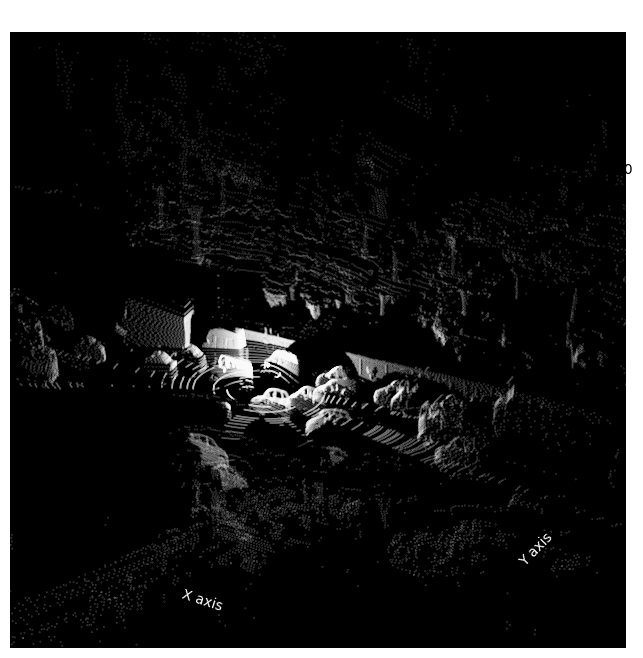

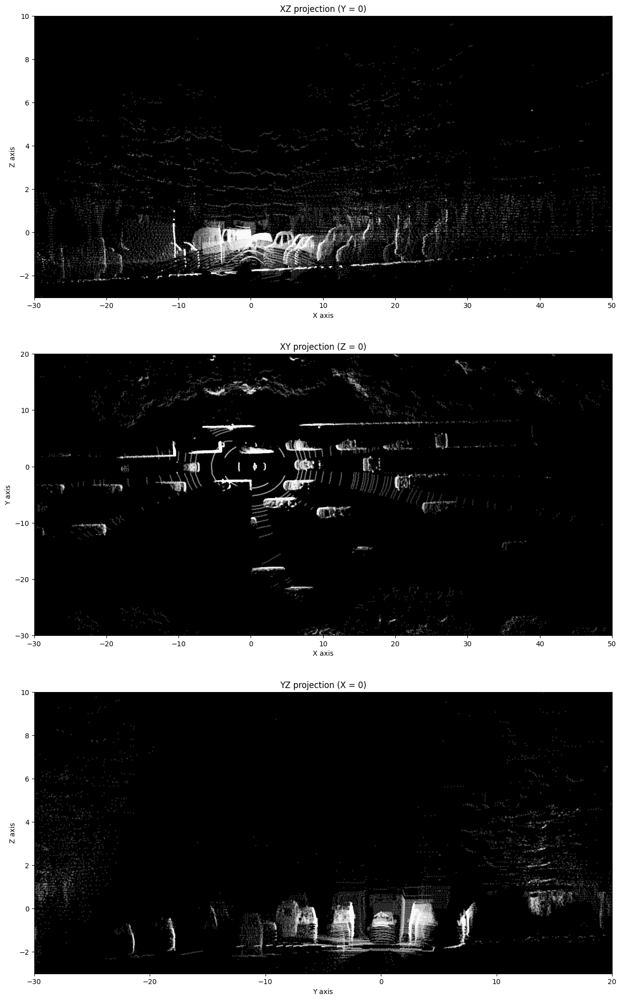

In [23]:
display_frame_statistics(pc.points, points=0.5)

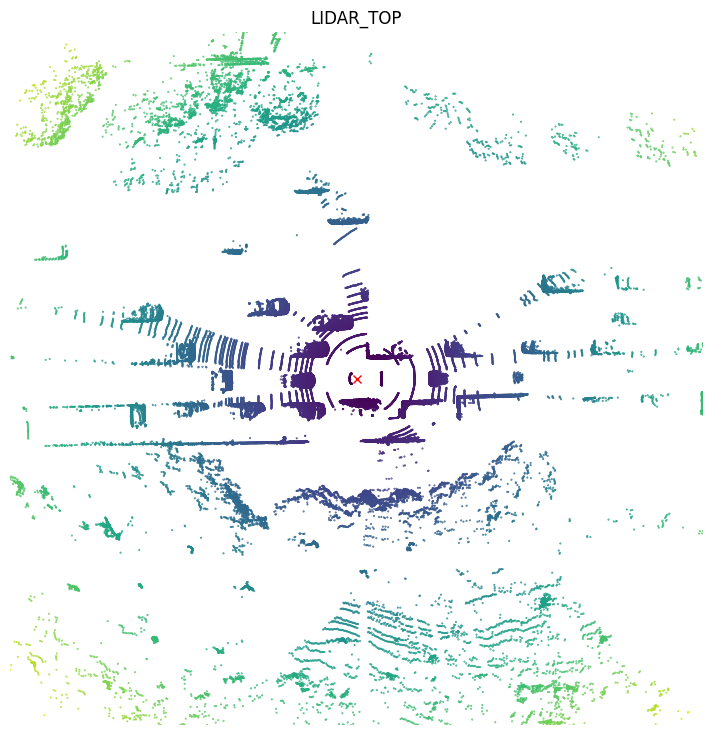

In [24]:
lyftdata.render_sample_data(lidar_top['token'], with_anns=False)

In [25]:
lyftdata.get('ego_pose', cam_front['ego_pose_token'])

{'rotation': [0.2781972991626702,
  -3.898219099753439e-05,
  0.010984161409140781,
  0.9604611441474988],
 'translation': [2706.450326057958, 694.5009240389028, -19.260889292536774],
 'token': 'dfba284cabe099bbe89ff13355a7702828d02709f82579f1e49081479cb09dfe',
 'timestamp': 1558109692502687.0}

In [26]:
lyftdata.get('calibrated_sensor', cam_front['calibrated_sensor_token'])

{'sensor_token': 'eb9e8f60a3d6e3328d7512b9f8e6800127fe91f4d62bc8e48a0e6a7cb116cc60',
 'rotation': [0.5090416344726354,
  -0.49422295323980653,
  0.4930125688749941,
  -0.5035463174283287],
 'camera_intrinsic': [[1109.05239567, 0, 957.849065461],
  [0.0, 1109.05239567, 539.672710373],
  [0.0, 0.0, 1.0]],
 'translation': [1.5039405282244198, -0.02676183592864872, 1.6584901808053665],
 'token': '8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de86ead47fa25fd13fd20'}

In [27]:
my_annotation = lyftdata.get('sample_annotation', my_sample['anns'][0])
my_annotation

{'token': '92bff46db1dbfc9679edc8091770c4256ac3c027e9f0a9c31dfc4fff41f6f677',
 'num_lidar_pts': -1,
 'size': [2.064, 5.488, 2.053],
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'rotation': [0.265491936795379, 0, 0, 0.964113080243515],
 'prev': 'db2c5aea69d8be40a746c5f3df9366e030189b07647212f338b31240c15896df',
 'translation': [2680.2830359778527, 698.1969292852777, -18.04776692365821],
 'num_radar_pts': 0,
 'attribute_tokens': ['1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2',
  'daf16a3f6499553cc5e1df4a456de5ee46e2e6b06544686d918dfb1ddb088f6f'],
 'next': '33e07b849d62718279c9548fe662d32247e319f0451cd461059305c3e42dcea0',
 'instance_token': 'abea2eb040d9c8fa1a44fa54020daaf9e2aa696e95e1d257481ecbf6e13a318c',
 'visibility_token': '',
 'category_name': 'car'}

In [28]:
my_box = lyftdata.get_box(my_annotation['token'])
my_box 

label: nan, score: nan, xyz: [2680.28, 698.20, -18.05], wlh: [2.06, 5.49, 2.05], rot axis: [0.00, 0.00, 1.00], ang(degrees): 149.21, ang(rad): 2.60, vel: nan, nan, nan, name: car, token: 92bff46db1dbfc9679edc8091770c4256ac3c027e9f0a9c31dfc4fff41f6f677

In [29]:
my_box.center, my_box.wlh 

(array([2680.28303598,  698.19692929,  -18.04776692]),
 array([2.064, 5.488, 2.053]))

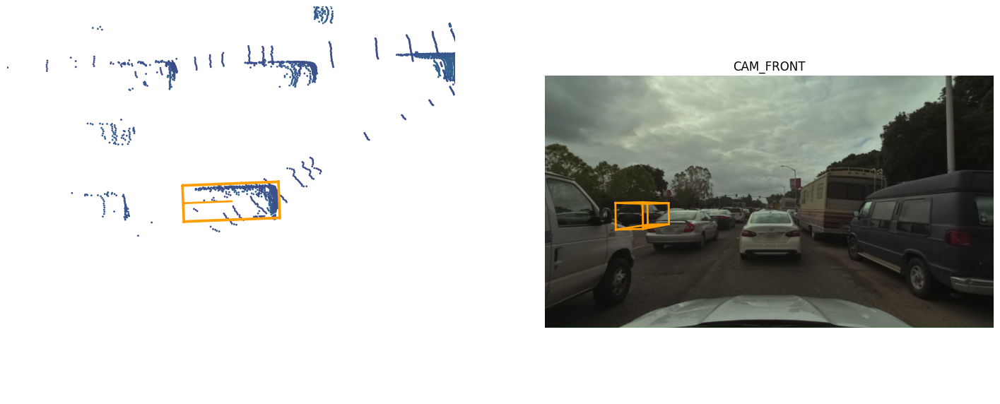

In [30]:
lyftdata.render_annotation(my_annotation['token'], margin=10)

In [31]:
my_attribute1 = lyftdata.get('attribute', my_annotation['attribute_tokens'][0])
my_attribute2 = lyftdata.get('attribute', my_annotation['attribute_tokens'][1])

In [32]:
my_attribute1

{'description': '',
 'token': '1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2',
 'name': 'object_action_stopped'}

In [33]:
my_attribute2

{'description': '',
 'token': 'daf16a3f6499553cc5e1df4a456de5ee46e2e6b06544686d918dfb1ddb088f6f',
 'name': 'is_stationary'}

In [34]:
my_instance = lyftdata.get('instance', my_annotation['instance_token'])
my_instance

{'category_token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c',
 'last_annotation_token': '1b7d368056d75ac9082d30c84a4ffc2468cccc960aad11f1c171ec66390c8fff',
 'token': 'abea2eb040d9c8fa1a44fa54020daaf9e2aa696e95e1d257481ecbf6e13a318c',
 'first_annotation_token': '754eca53d8bce9fdc0da74ed71b35f83690bb8a8c8d5fa8e8d22d9d68031af33',
 'nbr_annotations': 100}

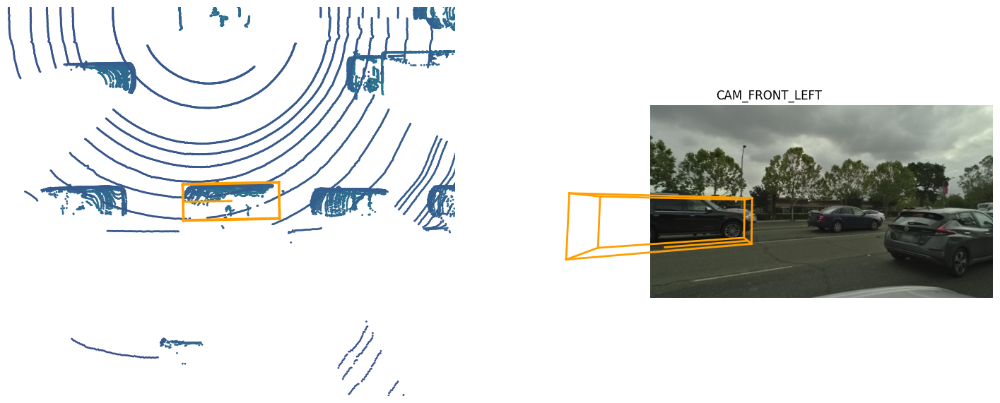

In [35]:
lyftdata.render_instance(my_instance['token'])

First annotated sample of this instance:


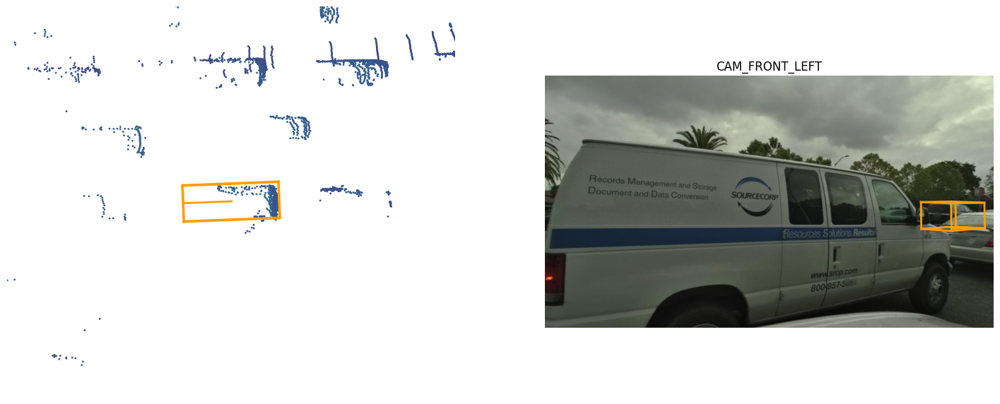

In [36]:
print("First annotated sample of this instance:")
lyftdata.render_annotation(my_instance['first_annotation_token'])

Last annotated sample of this instance


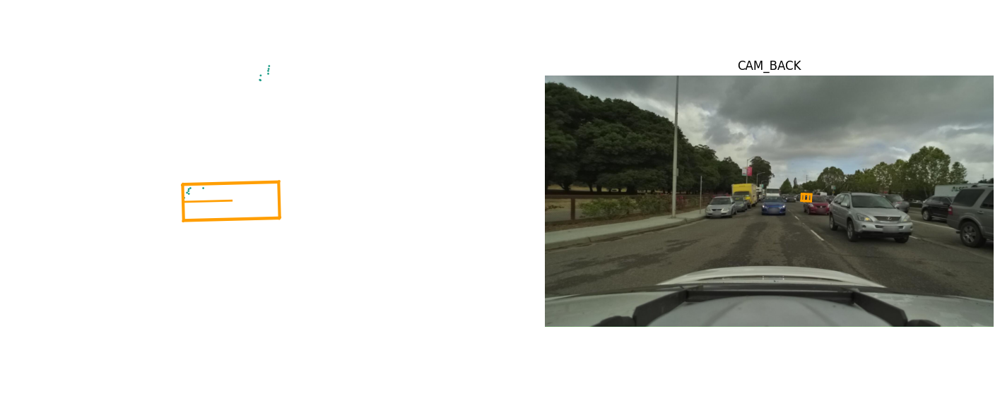

In [37]:
print("Last annotated sample of this instance")
lyftdata.render_annotation(my_instance['last_annotation_token'])

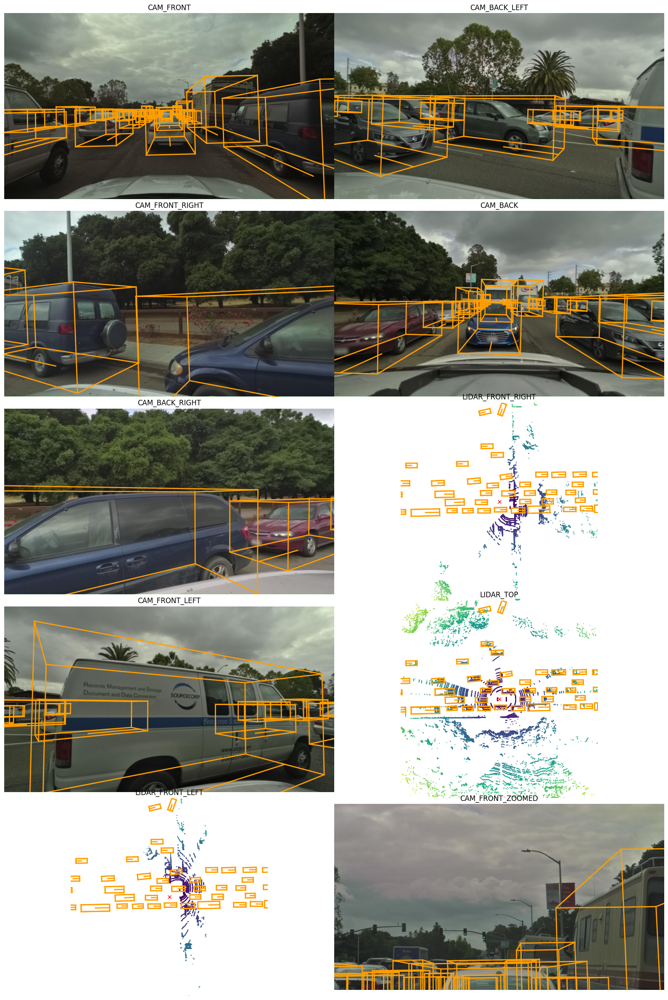

In [38]:
lyftdata.render_sample(token0)

In [39]:
my_scene = lyftdata.get('scene',  my_sample['scene_token'])

In [40]:
def get_lidar_points(lidar_token):
    '''Get lidar point cloud in the frame of the ego vehicle'''
    sd_record = lyftdata.get("sample_data", lidar_token)
    sensor_modality = sd_record["sensor_modality"]
    
    
    sample_rec = lyftdata.get("sample", sd_record["sample_token"])
    chan = sd_record["channel"]
    ref_chan = "LIDAR_TOP"
    pc, times = LidarPointCloud.from_file_multisweep(
        lyftdata, sample_rec, chan, ref_chan, num_sweeps=1
    )
    
    cs_record = lyftdata.get("calibrated_sensor", sd_record["calibrated_sensor_token"])
    pose_record = lyftdata.get("ego_pose", sd_record["ego_pose_token"])
    vehicle_from_sensor = np.eye(4)
    vehicle_from_sensor[:3, :3] = Quaternion(cs_record["rotation"]).rotation_matrix
    vehicle_from_sensor[:3, 3] = cs_record["translation"]
    
    ego_yaw = Quaternion(pose_record["rotation"]).yaw_pitch_roll[0]
    rot_vehicle_flat_from_vehicle = np.dot(
        Quaternion(scalar=np.cos(ego_yaw / 2), vector=[0, 0, np.sin(ego_yaw / 2)]).rotation_matrix,
        Quaternion(pose_record["rotation"]).inverse.rotation_matrix,
    )
    vehicle_flat_from_vehicle = np.eye(4)
    vehicle_flat_from_vehicle[:3, :3] = rot_vehicle_flat_from_vehicle
    points = view_points(
        pc.points[:3, :], np.dot(vehicle_flat_from_vehicle, vehicle_from_sensor), normalize=False
    )
    return points

In [41]:
def plot_box(box, axis, view, colors, normalize=False, linewidth=1.0):
    '''Plot boxes in the 3d figure'''
    corners = view_points(box.corners(), view, normalize=normalize)#
    def draw_rect(selected_corners, color):
        prev = selected_corners[-1]
        for corner in selected_corners:
            axis.plot([prev[0], corner[0]], [prev[1], corner[1]], [prev[2], corner[2]], color=color, linewidth=linewidth)
            prev = corner

   
    for i in range(4):
        axis.plot(
            [corners.T[i][0], corners.T[i + 4][0]],
            [corners.T[i][1], corners.T[i + 4][1]],
            [corners.T[i][2], corners.T[i + 4][2]],
            color=colors[2],
            linewidth=linewidth,
        )

    
    draw_rect(corners.T[:4], colors[0]) 
    draw_rect(corners.T[4:], colors[1])

In [42]:
def draw_3d_plot(idx, lidar_token):
    '''Plot the lidar + annotations on a 3D figure'''
   
    lidar_points = get_lidar_points(lidar_token)
    points = 0.5 
    points_step = int(1. / points)
    pc_range = range(0, lidar_points.shape[1], points_step)
    lidar_points = lidar_points[:, pc_range]
    
    
    _, boxes, _ = lyftdata.get_sample_data(
        lidar_token, flat_vehicle_coordinates=True
    )
    fig = plt.figure(figsize=(15, 8))
    ax = fig.add_subplot(111, projection='3d')                    
    point_size = 0.01 * (1. / points) 
    ax.set_facecolor('black')
    ax.grid(False)
    ax.scatter(*lidar_points, s=point_size, c='white', cmap='gray')
    for box in boxes:
        c = np.array(lyftdata.explorer.get_color(box.name)) / 255.0
        plot_box(box, ax, view=np.eye(3), colors=(c, c, c), linewidth=0.5)
    ax.set_xlim3d(-40, 40)
    ax.set_ylim3d(-40, 40)
    ax.set_zlim3d(-4, 40)
    
   
    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.set_title(lidar_token, color='white')
    filename = 'tmp/frame_{0:0>4}.png'.format(idx)
    plt.savefig(filename)
    plt.close(fig)
    return filename

In [43]:
!mkdir tmp 

A subdirectory or file tmp already exists.


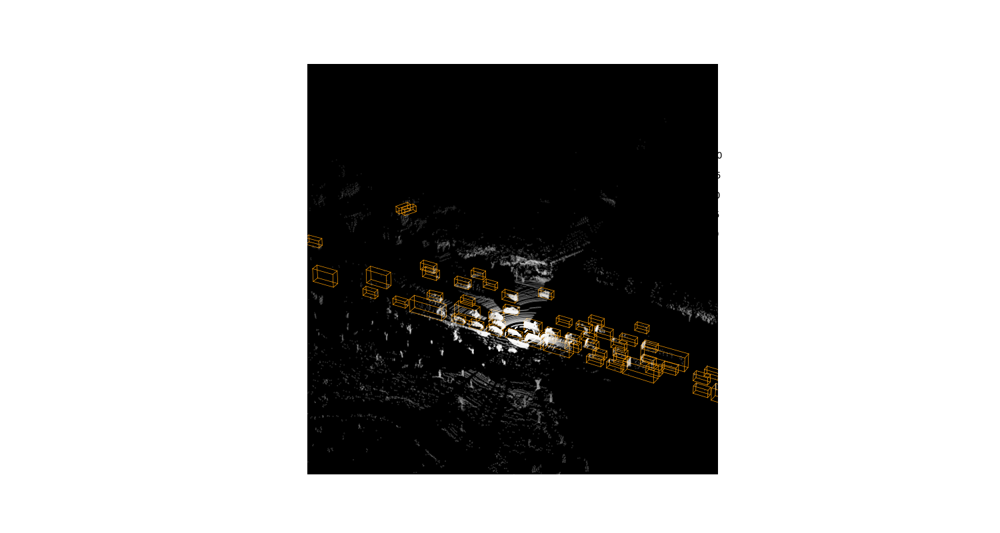

In [44]:

first_sample_token = my_scene['first_sample_token']
sample = lyftdata.get('sample', first_sample_token)
lidar_token = sample['data']['LIDAR_TOP']
filename = draw_3d_plot(0, lidar_token)
Image.open(filename)

Let's visualize `my_scene` in the form of a video

In [45]:
frames = []
first_sample_token = my_scene['first_sample_token']
token = first_sample_token
for i in tqdm(range(my_scene['nbr_samples'])):
    sample = lyftdata.get('sample', token)
    lidar_token = sample['data']['LIDAR_TOP']
    filename = draw_3d_plot(i, lidar_token)
    frames += [filename]
    token = sample['next']
#     break

  0%|          | 0/126 [00:00<?, ?it/s]

In [46]:
from moviepy.video.io.ImageSequenceClip import ImageSequenceClip


clip = ImageSequenceClip(frames, fps=5)
clip.write_gif('pcl_data.gif', fps=5)

MoviePy - Building file pcl_data.gif with imageio.


In [47]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from IPython import display

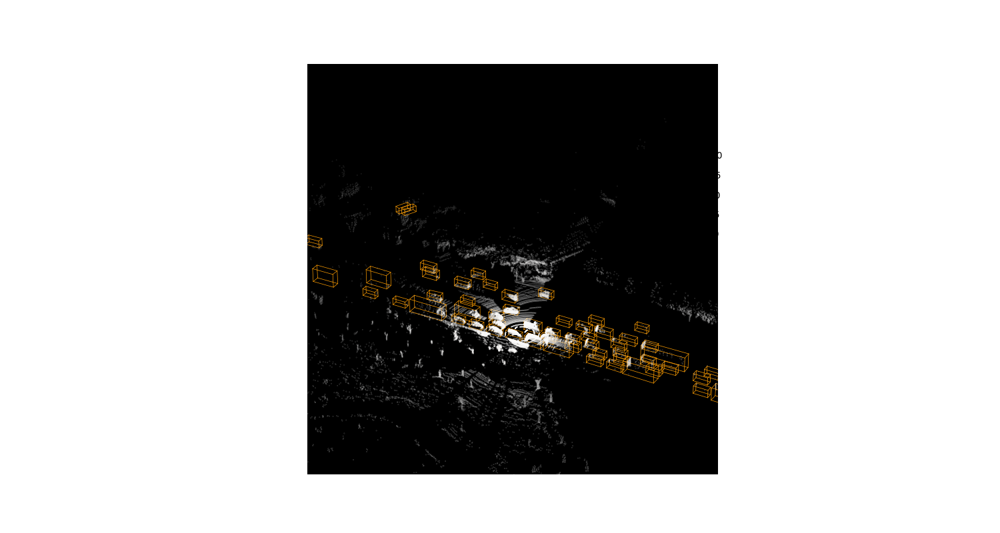

In [48]:
with open('pcl_data.gif','rb') as f:
    display.Image(data=f.read(), format='png')